In [1]:
import pandas as pd
import numpy as np
import warnings
warnings.filterwarnings('ignore')

"""
 Process all runs data to determine scrutinized hits based on IC50.
"""
# ic50 from all runs
all_runs_df = pd.read_csv('../datasets/Zenodo/v1/enamine_dose_reponse_curves.tsv', delimiter='\t')

cols_to_keep = ['Molecule Name', 'Synonyms',
                 'PriA-SSB Dose response: Run Date',
                 'PriA-SSB Dose response: IC50 (uM)',
                 'PriA-SSB Dose response: IC50 CI (Lower) (uM)',
                 'PriA-SSB Dose response: IC50 CI (Upper) (uM)',
                 'PriA-SSB Dose response: Curve class']

all_runs_df = all_runs_df[cols_to_keep]

run_dates_dict = {'2021-07-01': '16-point dose-response', 
                  '2021-06-16': '8-point dose-response', 
                  '2021-05-21': '16-point dose-response'}
run_dates = ['2021-07-01', '2021-06-16', '2021-05-21'] 
curve_classes = [1.2, 2.2, 2.4, 3., 4.]
run_date_col = 'PriA-SSB Dose response: Run Date'
curve_class_col = 'PriA-SSB Dose response: Curve class'

rows_to_keep = []
for mol_id in all_runs_df['Molecule Name'].unique():
    temp_df = all_runs_df[all_runs_df['Molecule Name'] == mol_id]
    
    if '2021-07-01' in temp_df[run_date_col].tolist():
        rows_to_keep.append(temp_df[temp_df[run_date_col] == '2021-07-01'])
    elif '2021-05-21' in temp_df[run_date_col].tolist():
        rows_to_keep.append(temp_df[temp_df[run_date_col] == '2021-05-21'])
    else:
        rows_to_keep.append(temp_df[temp_df[run_date_col] == '2021-06-16'])

keep_df = pd.concat(rows_to_keep, axis=0)

# define scrutinized hits. curve class 1.2 always hit. 
# curve class 2.2 + well defined ic50 to determine hit. upper and lower bound should exist and within reasonable range.
keep_df['Scrutinized Hit'] = 0
keep_df.loc[keep_df[curve_class_col] == 1.2, 'Scrutinized Hit'] = 1

curve_class_2_hits = (keep_df[curve_class_col] == 2.2) \
& (~keep_df['PriA-SSB Dose response: IC50 CI (Lower) (uM)'].isna()) \
& (~keep_df['PriA-SSB Dose response: IC50 CI (Upper) (uM)'].isna()) \
& (~keep_df['PriA-SSB Dose response: IC50 (uM)'].isna()) \
& (np.abs(keep_df['PriA-SSB Dose response: IC50 CI (Upper) (uM)']) < 100.0) 
#& (np.abs(keep_df['PriA-SSB Dose response: IC50 CI (Upper) (uM)'] - keep_df['PriA-SSB Dose response: IC50 CI (Lower) (uM)']) < 500.0) 

keep_df.loc[curve_class_2_hits, 'Scrutinized Hit'] = 1

assert keep_df['Scrutinized Hit'].sum() == 28

ic50_hits_df = keep_df.rename({'Molecule Name' : 'SMSSF Molecule ID', 'Synonyms': 'ID Enamine', 'SMILES': 'SMSSF SMILES'}, axis=1)
del all_runs_df, keep_df

In [2]:
import pandas as pd
import numpy as np
import warnings
warnings.filterwarnings('ignore')

concentration_col = 'Concentration (uM)'
concentration_val = 33
ic50_col = 'PriA-SSB Dose response: IC50 (uM)'
median_inhib_col = 'Median % negative control (%)'
inhib_col = '% negative control (%)'

# just process the 2021-06-16 dose_response run
# this file can be found in enamine_PriA-SSB_dose_response_data.tar.gz
res_full_df = pd.read_csv('../datasets/Zenodo/v1/enamine_PriA-SSB_dose_response_2021-06-16_run.tsv', delimiter='\t', keep_default_na=False)
res_full_df = res_full_df[res_full_df['Control State'] == '']
res_full_df[concentration_col] = res_full_df[concentration_col].astype(float)
res_df = res_full_df[res_full_df[concentration_col] == concentration_val]
res_df = res_df[['Molecule Name', 'Structure (CXSMILES)', concentration_col, inhib_col]]
res_df.index = res_df['Molecule Name'].tolist()
res_df[median_inhib_col] = 0
for smssf_id, row in res_df.groupby('Molecule Name').median().iterrows():
    res_df.loc[smssf_id, median_inhib_col] = row[inhib_col]
    res_df.loc[smssf_id, median_inhib_col] = row[inhib_col]
res_df = res_df.reset_index(drop=True)

inhib_col = '% Inhibition'
hit_thresh = 50.0
res_df[inhib_col] = 100.0 - res_df[median_inhib_col]
res_df['Hit_median_50_thresh'] = (res_df[inhib_col] >= hit_thresh).astype(int)

# process all 3 dose_response runs
all_runs_df = pd.read_csv('../datasets/Zenodo/v1/enamine_dose_reponse_curves.tsv', delimiter='\t').drop_duplicates('Synonyms')
res_df = res_df.merge(all_runs_df[['Molecule Name', 'Synonyms']], on='Molecule Name')

assert res_df['Molecule Name'].unique().shape[0] == 68
assert res_df['Synonyms'].unique().shape[0] == 68

res_df = res_df.rename({'Molecule Name' : 'SMSSF Molecule ID', 'Synonyms': 'ID Enamine', 'Structure (CXSMILES)': 'SMSSF SMILES'}, axis=1)

In [3]:
import pandas as pd
import numpy as np
import warnings
warnings.filterwarnings('ignore')

hit_thresh = 50.0
concentration_val = 33
inhib_col = '% Inhibition'
ic50_col = 'PriA-SSB Dose response: IC50 (uM)'
median_inhib_col = 'Median % negative control (%)'

train_and_ams_df = pd.read_csv('../datasets/Zenodo/v1/train_ams_real_cluster.csv.gz')
train_and_ams_df = train_and_ams_df[train_and_ams_df['dataset'].isin(['train', 'ams'])]

cpd_info_df = pd.read_csv('../datasets/Zenodo/v1/enamine_final_list.csv.gz').drop('Hit', axis=1)
res_df = res_df.drop_duplicates('SMSSF Molecule ID')

res_df = res_df.merge(cpd_info_df, on='ID Enamine')

top_real_clustering = pd.read_csv('./enamine_final_list/enamine_costs_clustered_v3_with_nneighbor.csv.gz')

scrutinized_df = ic50_hits_df.copy()
scrutinized_df = scrutinized_df.merge(cpd_info_df, on='ID Enamine')
scrutinized_df = scrutinized_df.merge(res_df[['ID Enamine', 'Hit_median_50_thresh']], on='ID Enamine')

# add shorpp AS Frequent hitters filter
shorpp_freqhitters_filter = pd.read_csv('../datasets/Zenodo/v1/enamine_shorpp_freq_hitters_filter.csv.gz')
shorpp_freqhitters_filter = shorpp_freqhitters_filter[['rdkit SMILES', 'AS FRH Filter']]

scrutinized_df = scrutinized_df.merge(shorpp_freqhitters_filter, on='rdkit SMILES')

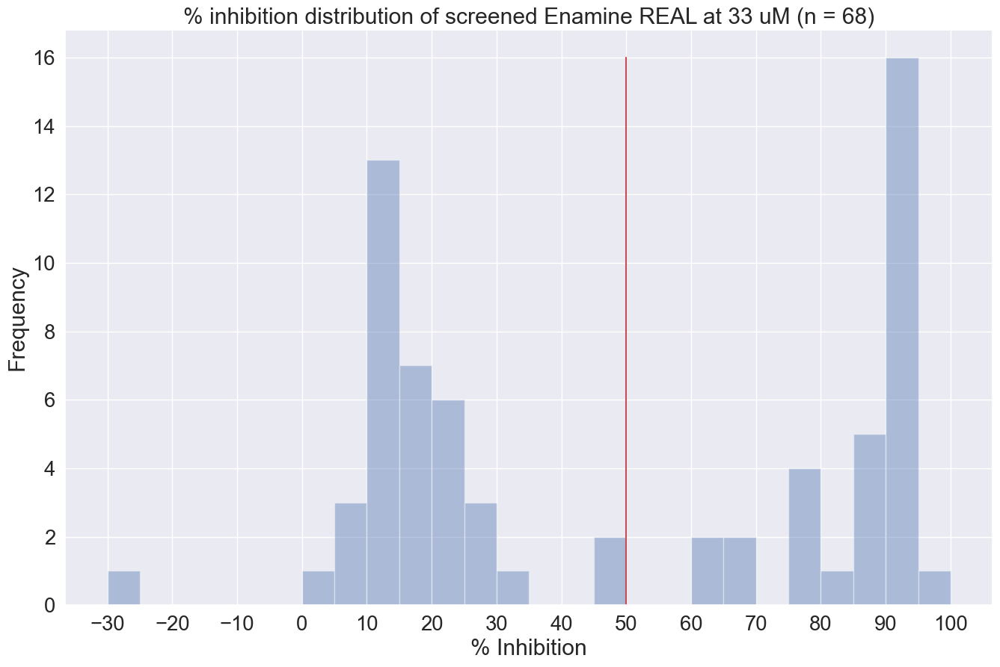

In [4]:
import seaborn as sns
import matplotlib.pyplot as plt
new_rc_params = {'text.usetex': False,
"svg.fonttype": 'none'
}
plt.rcParams.update(new_rc_params)

sns.set_context("paper");sns.set(font_scale=1.8);figsize=(16, 10)

bin_range=[i for i in range(-30, 101) if i%5==0]
plt.figure(figsize=figsize)

sns.distplot(res_df[inhib_col], norm_hist=False, kde=False, bins=bin_range)
plt.plot([hit_thresh, hit_thresh], [0, 16], color='r')
plt.title('% inhibition distribution of screened Enamine REAL at 33 uM (n = {})'.format(res_df.shape[0]))
plt.xlabel(inhib_col); plt.xticks([i for i in range(-30, 101) if i%10==0]); plt.ylabel('Frequency')

plt.savefig('./tmp_figures/real_screen_distribution.png')
plt.savefig('./tmp_figures/real_screen_distribution.svg')

plt.show()

---
## Total Hits of Ordered Compounds

In [5]:
counts, init_hits = scrutinized_df.shape[0], scrutinized_df['Hit_median_50_thresh'].sum()
AS_freq_hitters_among_inithits = scrutinized_df[scrutinized_df['Hit_median_50_thresh'] == 1]['AS FRH Filter'].sum()

scrutinized_hits = scrutinized_df['Scrutinized Hit'].sum()
AS_freq_hitters_among_scruthits = scrutinized_df[scrutinized_df['Scrutinized Hit'] == 1]['AS FRH Filter'].sum()

summary_df = pd.DataFrame(data=[[counts, init_hits, 100.0*(init_hits/counts), AS_freq_hitters_among_inithits,
                                 scrutinized_hits, 100.0*(scrutinized_hits/counts), AS_freq_hitters_among_scruthits]],
                          columns=['Count', 'Initial Hits', 'Initial Hit Rate', 'AS FRH Filter Among Initial Hits',
                                   'Scrutinized Hits', 'Scrutinized Hit Rate', 'AS FRH Filter Among Scrutinized Hits'], 
                          index=['RF-C Enamine REAL'])
summary_df

,Count,Initial Hits,Initial Hit Rate,AS FRH Filter Among Initial Hits,Scrutinized Hits,Scrutinized Hit Rate,AS FRH Filter Among Scrutinized Hits
RF-C Enamine REAL,68,31,45.588235,19,28,41.176471,17


---
## Look at clusters/novel hits

Unique cluster hits counts the number of unique clusters with hits in the prospective dataset.

Novel cluster hits counts the number of unique clusters with hits that were NOT present in the training set. In other words, clusters that the model was not trained on. 

In [6]:
train_hits = train_and_ams_df[train_and_ams_df['Hit'] == 1]

cluster_cols = ['TB_0.4 ID']
cluster_summary = []
for df in [res_df]:
    ref_hits = df[df['Hit_median_50_thresh'] == 1]
    tmp_list = []
    for cluster_col in cluster_cols:
        cluster_hit_count = ref_hits[cluster_col].unique().shape[0]
        novel_cluster_count = np.setdiff1d(ref_hits[cluster_col].unique(), train_hits[cluster_col].unique()).shape[0]
        tmp_list.extend([cluster_hit_count, novel_cluster_count])
    cluster_summary.append(tmp_list)
cluster_hit_df = pd.DataFrame(data=cluster_summary,
                              columns=['Unique Cluster Hits (TB 0.4)', 'Novel Cluster Hits (TB 0.4)'],
                              index=['RF-C Enamine REAL'])
cluster_hit_df

,Unique Cluster Hits (TB 0.4),Novel Cluster Hits (TB 0.4)
RF-C Enamine REAL,31,31


In [7]:
summary_df = pd.concat([summary_df, cluster_hit_df], axis=1)
summary_df

,Count,Initial Hits,Initial Hit Rate,AS FRH Filter Among Initial Hits,Scrutinized Hits,Scrutinized Hit Rate,AS FRH Filter Among Scrutinized Hits,Unique Cluster Hits (TB 0.4),Novel Cluster Hits (TB 0.4)
RF-C Enamine REAL,68,31,45.588235,19,28,41.176471,17,31,31


In [8]:
cols = ['Is Train cluster?', 'Is Train active cluster?', 
        'Is AMS cluster?', 'Is AMS active cluster?']

res_hits = res_df[res_df['Hit_median_50_thresh'] == 1]
for c in cols:
    print(c, res_hits[c].sum())
    
res_hits[(res_hits['Is Train cluster?'] == 1) | (res_hits['Is AMS cluster?'] == 1)].shape

Is Train cluster? 4
Is Train active cluster? 0
Is AMS cluster? 2
Is AMS active cluster? 0


(5, 33)

---
# Get nearest training+ams actives and inactives to all 68 enamine cpds

## Compound Structures

,Prospective Mol ID,Prospective SMILES,Nearest Active SMILES,Nearest Inactive SMILES,Prospective Mol,Nearest Active Mol,Nearest Inactive Mol,Active Dataset:Tanimoto Distance,Active Tanimoto Distance,Inactive Dataset:Tanimoto Distance,Inactive Tanimoto Distance,Initial Hit,Scrutinized Hit,PriA-SSB Dose response: IC50 (uM),PriA-SSB Dose response: IC50 CI (Lower) (uM),PriA-SSB Dose response: IC50 CI (Upper) (uM),AS FRH Filter
0,Z734854148,C(=NNc1ncnc2nc[nH]c12)c1ccccn1,Nc1c(Cl)ncnc1NN=Cc1ccccn1,Fc1ccccc1C=NNc1ncnc2nc[nH]c12,,,,Training: 0.45,0.448980,Training: 0.35,0.354167,1,1,1.29,1.220000e+00,1.360000e+00,False
1,Z1763598930,Clc1cncnc1NN=Cc1ccccn1,Nc1c(Cl)ncnc1NN=Cc1ccccn1,Clc1cncc(Cl)c1N/N=C/c1ccccn1,,,,Training: 0.38,0.377778,AMS: 0.32,0.317073,1,1,1.70,1.610000e+00,1.810000e+00,False
2,Z50106757,C(=NNc1ncnc2sccc12)c1ccccn1,Nc1c(Cl)ncnc1NN=Cc1ccccn1,c1ccc(CCNc2ncnc3sccc23)nc1,,,,Training: 0.45,0.448980,Training: 0.49,0.490196,1,1,2.68,2.470000e+00,2.900000e+00,False
3,Z49571468,CC1CCC(=NNc2ccccc2[N+](=O)[O-])CC1,CC1CCC(=NNc2ccc(C(F)(F)F)cc2[N+](=O)[O-])CC1,O=[N+]([O-])c1ccccc1NN=C1CCc2ccccc21,,,,Training: 0.35,0.354167,Training: 0.47,0.468085,1,1,3.64,3.120000e+00,4.250000e+00,False
4,Z3559392588,O[C@@H]1COC[C@@H]1Nc1ccc2ccc3cccnc3c2n1,c1cnc2c(c1)ccc1cccnc12,Clc1ccc2ccc3cccnc3c2n1,,,,Training: 0.54,0.542857,Training: 0.59,0.585366,1,1,4.26,4.000000e+00,4.530000e+00,False
5,Z3558428795,OCCCCNc1ccc2ccc3cccnc3c2n1,c1cnc2c(c1)ccc1cccnc12,O=S(=O)(NCCO)c1cccc2cccnc12,,,,Training: 0.53,0.529412,Training: 0.54,0.543478,1,1,4.33,4.120000e+00,4.560000e+00,False
6,Z3559518523,OCCC(Nc1ccnc2c1ccc1cccnc12)C(F)F,Cc1ccnc2c1ccc1cccnc12,c1cnc2c(c1)ccc1c2ccc2cccnc21,,,,Training: 0.57,0.565217,AMS: 0.60,0.595238,1,1,4.48,4.170000e+00,4.810000e+00,False
7,Z2976359863,Cc1c(N)nc(-c2ccccn2)nc1NCC1CCC(C2CC2)O1,c1ccc(-c2nc(NCC3CCCO3)c3ccccc3n2)nc1,Cc1c(N)nc(-c2ccccn2)nc1Cl,,,,Training: 0.54,0.538462,AMS: 0.55,0.553571,1,1,5.44,5.070000e+00,5.840000e+00,True
8,PV-001914484112,Fc1cccc(CNc2nc(-c3ccccn3)nc3c2CCC3)c1F,NNc1nc(-c2ccccn2)nc2c1CCC2,Fc1cccc(CNc2ncnc3cc(Cl)ccc23)c1F,,,,AMS: 0.41,0.411765,Training: 0.61,0.612903,1,1,6.11,5.230000e+00,7.150000e+00,True
9,Z339655406,CC(C)N(C)S(=O)(=O)c1ccc(F)c(C(=O)Nc2nc(-c3ccccn3)cs2)c1,O=C(Nc1nc(-c2ccccn2)cs1)c1cc(S(=O)(=O)N2CCOCC2)ccc1F,CN(C)S(=O)(=O)c1ccc(C(=O)Nc2nc(-c3ccccn3)cs2)cc1,,,,Training: 0.36,0.357143,AMS: 0.39,0.390625,1,1,6.82,6.490000e+00,7.170000e+00,True

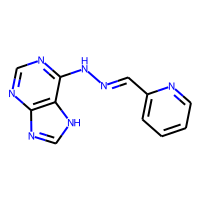
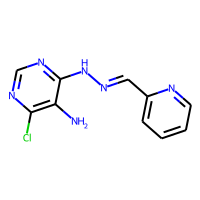
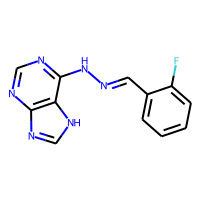
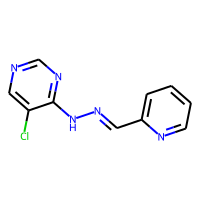
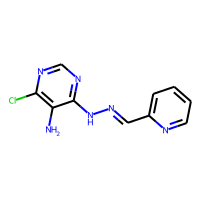
...
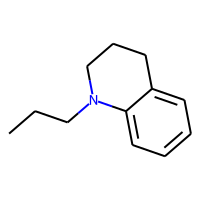
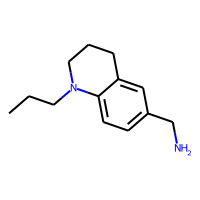
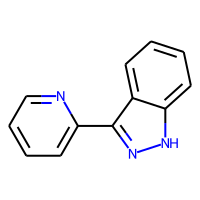
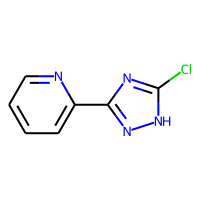
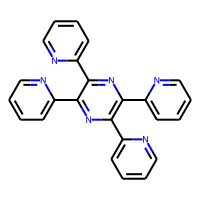

In [9]:
from sklearn.metrics import pairwise_distances, pairwise_distances_argmin
from rdkit import Chem
from rdkit.Chem.Draw import IPythonConsole 
from rdkit.Chem.Draw.MolDrawing import MolDrawing, DrawingOptions
from rdkit.Chem import PandasTools
from IPython.core.display import HTML
from rdkit.Chem import AllChem
PandasTools.RenderImagesInAllDataFrames(images=True)
DrawingOptions.atomLabelFontSize = 55
DrawingOptions.dotsPerAngstrom = 100
DrawingOptions.bondLineWidth = 3.0
from rdkit.Chem import rdFMCS

molid_col = 'ID Enamine'
inhib_col = '% Inhibition'
ic50_col = 'PriA-SSB Dose response: IC50 (uM)'
ic50_lower_col = 'PriA-SSB Dose response: IC50 CI (Lower) (uM)'
ic50_upper_col = 'PriA-SSB Dose response: IC50 CI (Upper) (uM)'
median_inhib_col = 'Median % negative control (%)'

ic50_vals = scrutinized_df[ic50_col].unique()

potency_dict = {}
for val in ic50_vals:
    try:
        potency_dict[val] = float(val)
    except:
        pass
potency_dict['> 66.0'] = 66.0
potency_dict['> 100'] = 100.0
potency_dict['< 4.17E-03'] = np.nan

scrutinized_df['Potency Order'] = 0
for i in range(scrutinized_df.shape[0]):
    scrutinized_df.loc[i, 'Potency Order'] = potency_dict[scrutinized_df.loc[i, ic50_col]]

def show(df): # see issue: https://github.com/rdkit/rdkit/issues/2673
    return HTML(df.to_html())

"""
    Finds nearest training+ams active and inactive to the prospective set
"""
def get_sim_df(train_df, prosp_df):
    X_prosp = np.vstack([np.fromstring(x, 'u1') - ord('0') for x in prosp_df['1024 MorganFP Radius 2']]).astype(float)
    # get actives distances
    train_actives_df = train_df[train_df['Hit'] == 1]
    X_train_actives = np.vstack([np.fromstring(x, 'u1') - ord('0') for x in train_actives_df['1024 MorganFP Radius 2']]).astype(float)
    train_actives_prosp_tandist = pairwise_distances(X_prosp, X_train_actives, metric='jaccard')
    # get inactives distances
    train_inactives_df = train_df[train_df['Hit'] != 1]
    X_train_inactives = np.vstack([np.fromstring(x, 'u1') - ord('0') for x in train_inactives_df['1024 MorganFP Radius 2']]).astype(float)
    train_inactives_prosp_tandist = pairwise_distances(X_prosp, X_train_inactives, metric='jaccard')
    
    sim_info = []
    for i in range(prosp_df.shape[0]):
        prosp_smiles = prosp_df['rdkit SMILES'].iloc[i]
        prosp_mol = Chem.MolFromSmiles(prosp_smiles)
        AS_frh_filter = prosp_df['AS FRH Filter'].iloc[i]
        
        # get nearest active to current prosp mol
        closest_active_idx = np.argmin(train_actives_prosp_tandist[i,:]) 
        active_dist = train_actives_prosp_tandist[i,closest_active_idx]
        active_smiles = train_actives_df['rdkit SMILES'].iloc[closest_active_idx] 
        active_mol = Chem.MolFromSmiles(active_smiles)
    
        # get nearest inactive to current prosp mol
        closest_inactive_idx = np.argmin(train_inactives_prosp_tandist[i,:]) 
        inactive_dist = train_inactives_prosp_tandist[i,closest_inactive_idx]
        inactive_smiles = train_inactives_df['rdkit SMILES'].iloc[closest_inactive_idx] 
        inactive_mol = Chem.MolFromSmiles(inactive_smiles)
        
        # try to align mols
        try:
            mcs = rdFMCS.FindMCS([prosp_mol, active_mol, inactive_mol], ringMatchesRingOnly=True, completeRingsOnly=True)
            template = Chem.MolFromSmarts(mcs.smartsString)
            AllChem.Compute2DCoords(template, nSample=500, sampleSeed=20211337)
            AllChem.GenerateDepictionMatching2DStructure(prosp_mol, template)
            AllChem.GenerateDepictionMatching2DStructure(active_mol, template)
            AllChem.GenerateDepictionMatching2DStructure(inactive_mol, template)
        except:
            pass
        
        active_dataset_name = train_actives_df['dataset'].iloc[closest_active_idx].replace('train', 'Training').replace('ams', 'AMS')
        active_dataset_dist = '{}: {:.2f}'.format(active_dataset_name, active_dist)
        
        inactive_dataset_name = train_inactives_df['dataset'].iloc[closest_inactive_idx].replace('train', 'Training').replace('ams', 'AMS')
        inactive_dataset_dist = '{}: {:.2f}'.format(inactive_dataset_name, inactive_dist)
        
        initial_hit = prosp_df['Hit_median_50_thresh'].iloc[i]
        scrutinized_hit = prosp_df['Scrutinized Hit'].iloc[i]
        ic50_val = prosp_df[ic50_col].iloc[i]
        ic50_lower_val = prosp_df[ic50_lower_col].iloc[i]
        ic50_upper_val = prosp_df[ic50_upper_col].iloc[i]
        potency_order = prosp_df['Potency Order'].iloc[i]
            
        sim_info.append((prosp_df[molid_col].iloc[i], 
                         prosp_smiles, active_smiles, inactive_smiles, 
                         prosp_mol, active_mol, inactive_mol,
                         active_dataset_dist, active_dist, 
                         inactive_dataset_dist, inactive_dist, 
                         initial_hit, scrutinized_hit, 
                         ic50_val, ic50_lower_val, ic50_upper_val, potency_order, AS_frh_filter))
        
    sim_df = pd.DataFrame(data=sim_info, 
                          columns=['Prospective Mol ID', 
                                   'Prospective SMILES', 'Nearest Active SMILES', 'Nearest Inactive SMILES',
                                   'Prospective Mol', 'Nearest Active Mol', 'Nearest Inactive Mol',
                                   'Active Dataset:Tanimoto Distance', 'Active Tanimoto Distance', 
                                   'Inactive Dataset:Tanimoto Distance', 'Inactive Tanimoto Distance',
                                   'Initial Hit', 'Scrutinized Hit', 
                                   ic50_col, ic50_lower_col, ic50_upper_col, 'Potency Order', 'AS FRH Filter'])
    sim_df = sim_df.sort_values('Potency Order', ascending=True).reset_index(drop=True)
    sim_df = sim_df.drop('Potency Order', axis=1)
    return sim_df

# get nearest training+ams active and inactive to all 68 enamines cpds
sim_df = get_sim_df(train_and_ams_df, scrutinized_df)
show(sim_df)

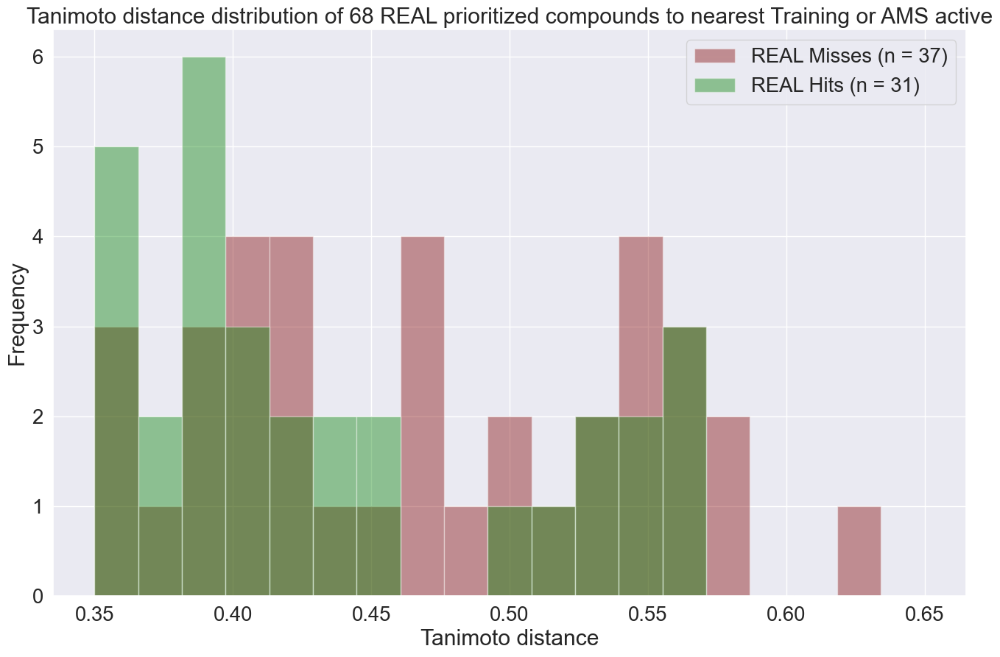

In [10]:
import seaborn as sns
import matplotlib.pyplot as plt
new_rc_params = {'text.usetex': False,
"svg.fonttype": 'none'
}
plt.rcParams.update(new_rc_params)
sns.set_context("paper");sns.set(font_scale=1.8);figsize=(16, 10)

tan_dist = sim_df['Active Tanimoto Distance'].values
bin_range= np.linspace(0.35, 0.65, 20) #[0.35, 0.4, 0.45, 0.5, 0.55, 0.6, 0.65] #np.linspace(0.35, 0.65, 10)
plt.figure(figsize=figsize)
prosp_hits_dist = sim_df[sim_df['Initial Hit'] == 1]['Active Tanimoto Distance'].values
prosp_misses_dist = sim_df[sim_df['Initial Hit'] == 0]['Active Tanimoto Distance'].values

sns.distplot(prosp_misses_dist, bins=bin_range, norm_hist=False, kde=False, color='maroon')  
sns.distplot(prosp_hits_dist, bins=bin_range, norm_hist=False, kde=False, color='green')  
plt.title('Tanimoto distance distribution of 68 REAL prioritized compounds to nearest Training or AMS active')
plt.xlabel('Tanimoto distance'); plt.ylabel('Frequency');
plt.legend(['REAL Misses (n = {})'.format(prosp_misses_dist.shape[0]), 
            'REAL Hits (n = {})'.format(prosp_hits_dist.shape[0])])


plt.show()

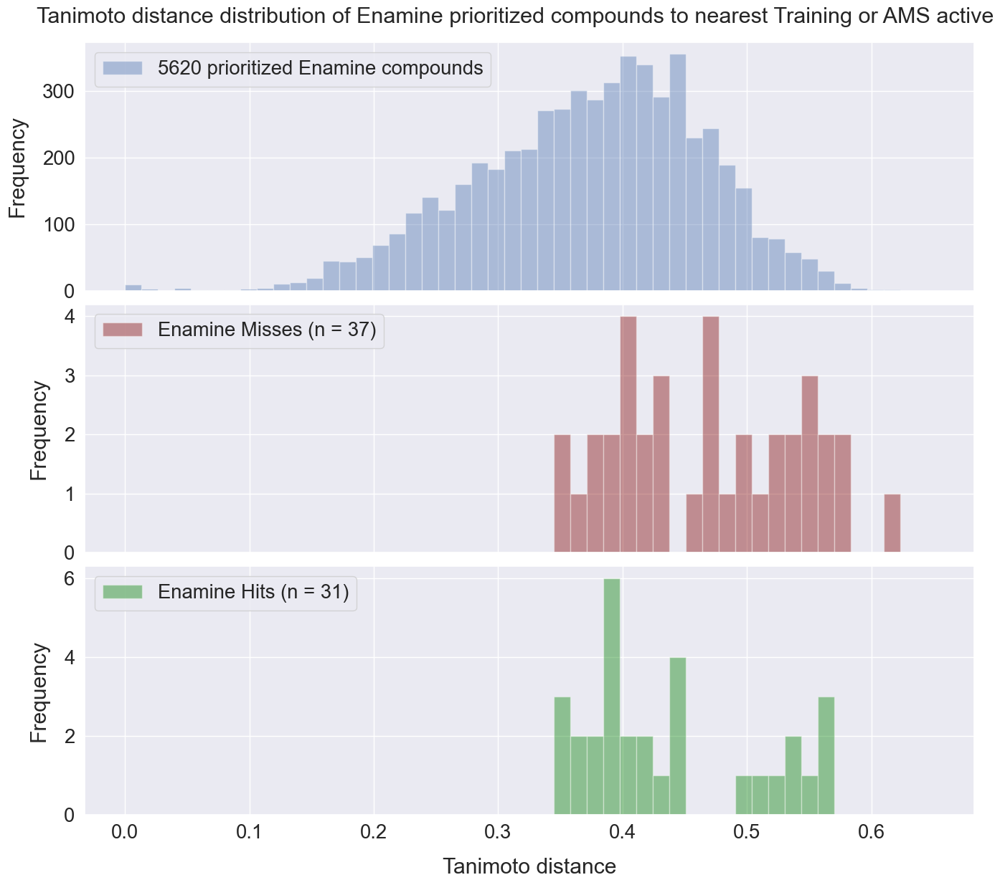

In [11]:
import seaborn as sns
import matplotlib.pyplot as plt
new_rc_params = {'text.usetex': False,
"svg.fonttype": 'none'
}
plt.rcParams.update(new_rc_params)
sns.set_context("paper");sns.set(font_scale=1.8);figsize=(16, 14)

tan_dist = sim_df['Active Tanimoto Distance'].values
bin_range= np.linspace(0.0, 0.65, 50) 
prosp_hits_dist = sim_df[sim_df['Initial Hit'] == 1]['Active Tanimoto Distance'].values
prosp_misses_dist = sim_df[sim_df['Initial Hit'] == 0]['Active Tanimoto Distance'].values
legends = ['5620 prioritized Enamine compounds',
           'Enamine Misses (n = {})'.format(prosp_misses_dist.shape[0]), 
           'Enamine Hits (n = {})'.format(prosp_hits_dist.shape[0])]

fig, axes = plt.subplots(3,1, figsize=figsize, sharex=True)

#plt.title('Tanimoto distance distribution of 5620 purchaseable Enamine REAL\n compounds to nearest Training or AMS active')
tan_5620_dist = top_real_clustering[['Closest Train Active TanDist', 'Closest AMS Active TanDist']].min(axis=1).values
sns.distplot(tan_5620_dist, bins=bin_range, norm_hist=False, kde=False, ax=axes[0])  
sns.distplot(prosp_misses_dist, bins=bin_range, norm_hist=False, kde=False, ax=axes[1], color='maroon')
sns.distplot(prosp_hits_dist, bins=bin_range, norm_hist=False, kde=False, ax=axes[2],color='green')

for i, ax in enumerate(axes):
    #ax.set_xlim([0.35,0.65])
    #ax.set_ylim([0,9.5])
    #ax.set_xticks([int(i) for i in np.linspace(35, 165, 14)])
    ax.set_ylabel('Frequency', labelpad=15);
    ax.legend([legends[i]], loc='upper left')
    
plt.subplots_adjust(wspace=0, hspace=0.055)
plt.xlabel('Tanimoto distance', labelpad=15)
plt.suptitle('Tanimoto distance distribution of Enamine prioritized compounds to nearest Training or AMS active', 
             y=.915, fontsize=22)

plt.savefig('./tmp_figures/real_tandist.png')
plt.savefig('./tmp_figures/real_tandist.svg')
plt.show()

### Similarity Heatmaps

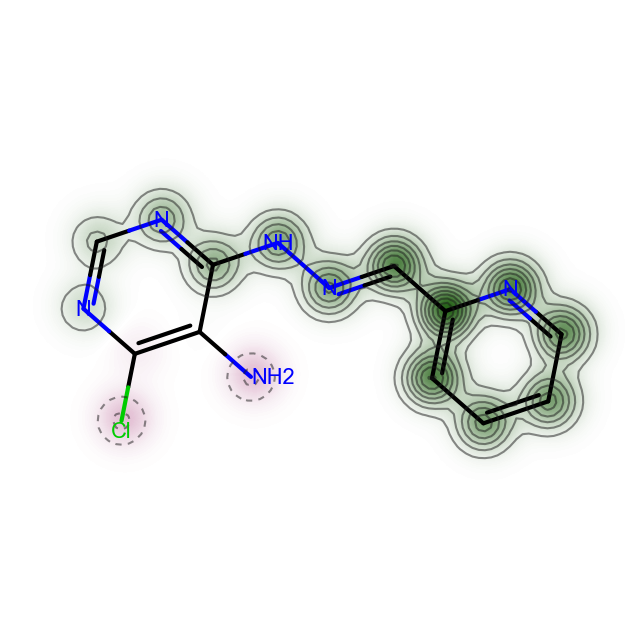

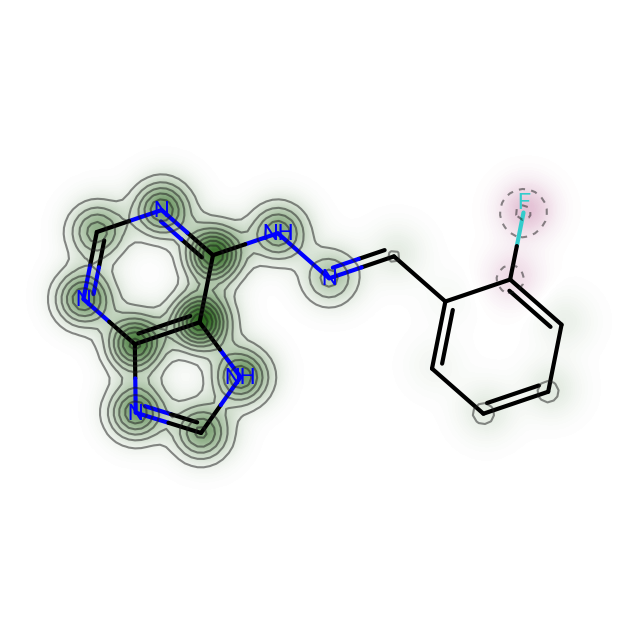

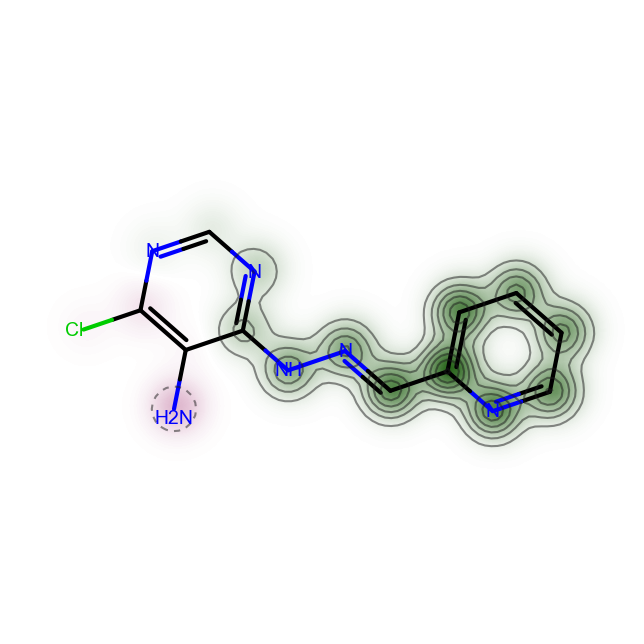

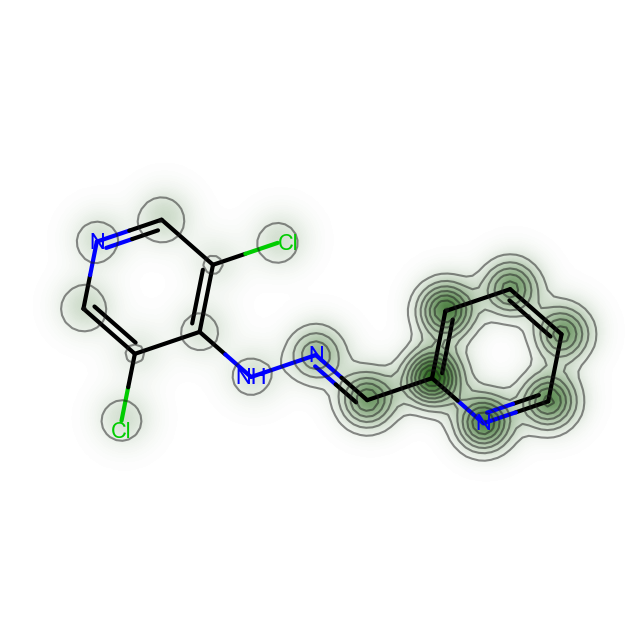

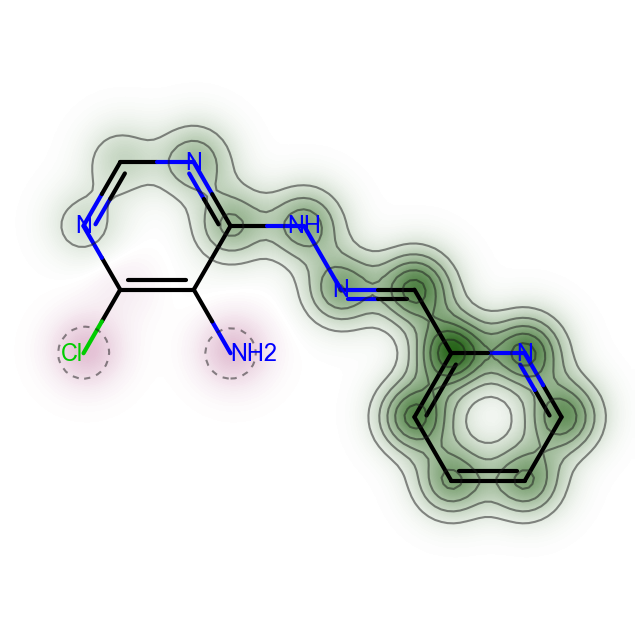

...

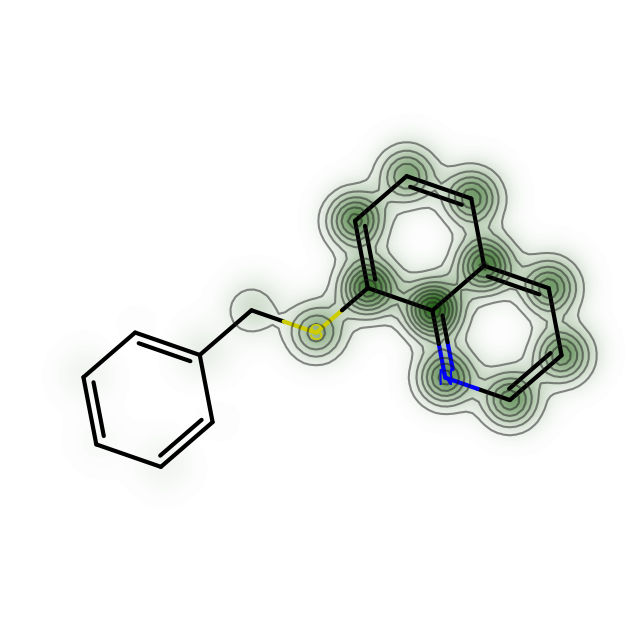

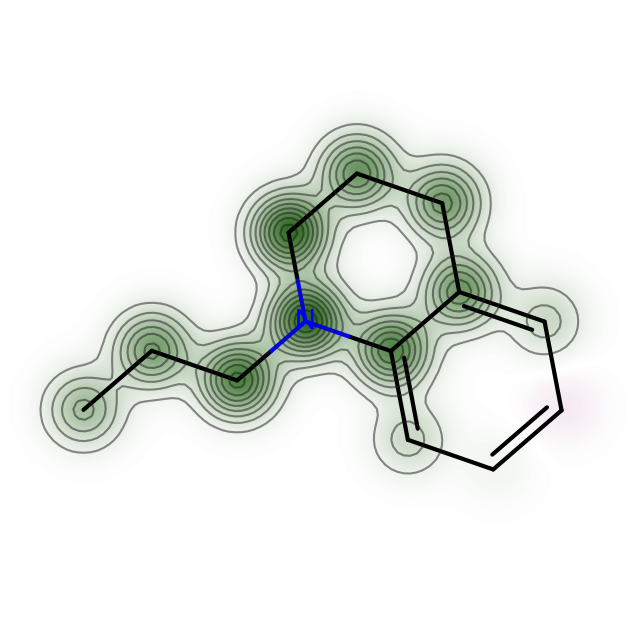

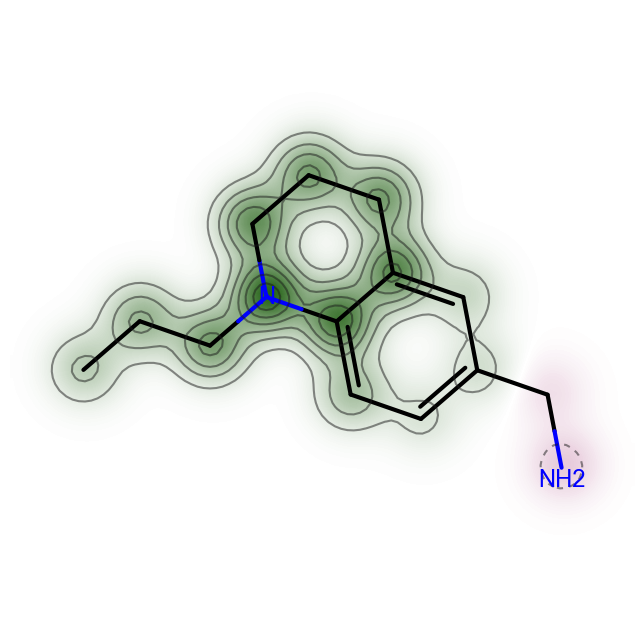

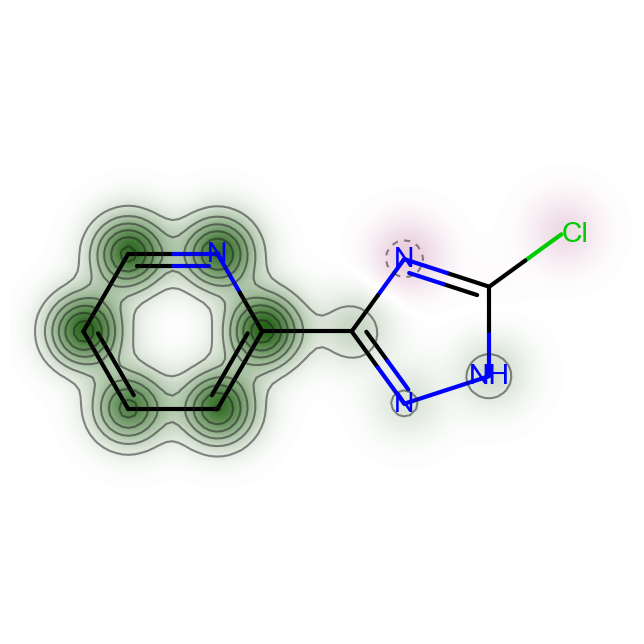

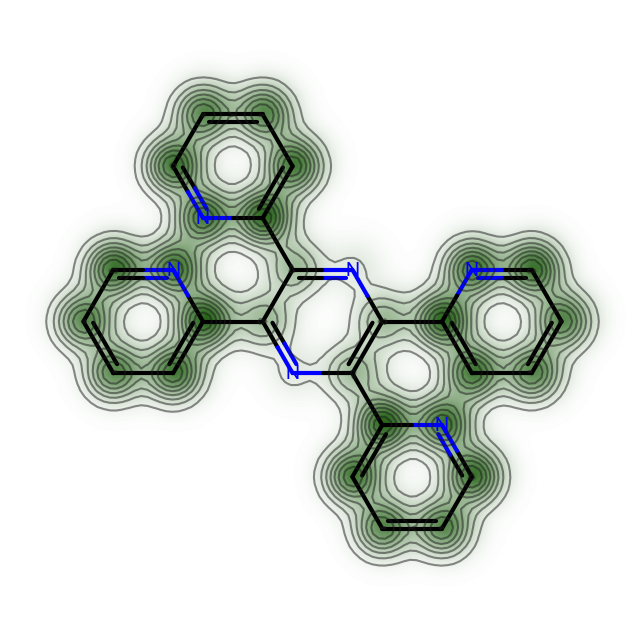

In [12]:
from rdkit import Chem
from rdkit.Chem import Draw
from rdkit.Chem.Draw import DrawingOptions
from rdkit.Chem.Draw import SimilarityMaps
FP_radius=2
tmp_df = sim_df.copy() #sim_df[sim_df['Is Hit?'] == 1]

for i in range(tmp_df.shape[0]):
    prosp_mol = tmp_df.iloc[i,4]
    active_mol = tmp_df.iloc[i,5]
    inactive_mol = tmp_df.iloc[i,6]
    
    Draw.MolToFile(prosp_mol, "./real_results_vis/rf_{}_{}.svg".format(i, 'prosp'))
    Draw.MolToFile(active_mol, "./real_results_vis/rf_{}_{}.svg".format(i, 'active'))
    Draw.MolToFile(inactive_mol, "./real_results_vis/rf_{}_{}.svg".format(i, 'inactive'))
    
    sim_func = (lambda a, b: SimilarityMaps.GetMorganFingerprint(a, atomId=b, fpType='bv', radius=FP_radius, nBits=1024))
    
    # get heatmap for active and prosp
    fig, maxweight = SimilarityMaps.GetSimilarityMapForFingerprint(prosp_mol, active_mol, sim_func)
    fig.savefig("./real_results_vis/rf_{}_{}.svg".format(i, 'hmapactive'), bbox_inches='tight')
    
    # get heatmap for inactive and prosp
    fig, maxweight = SimilarityMaps.GetSimilarityMapForFingerprint(prosp_mol, inactive_mol, sim_func)
    fig.savefig("./real_results_vis/rf_{}_{}.svg".format(i, 'hmapinactive'), bbox_inches='tight')

In [ ]:
# Generate latex table 
###### prefix = '\Includegraphics[trim=0cm 0cm 0cm 0cm,clip,width=0.15\linewidth]{figures/real/real_vis/'
image_fmt = 'rf_{}_{}'
row_fmt = '{} & {} & {} & {} ({}, {}) & {} \\\\'
sim_df = sim_df.round(2)

prefix = '\\Includegraphics[trim=0cm 0cm 0cm 0cm,clip,width=0.15\\linewidth]{figures/real/real_vis_png/'
for i, row in sim_df.iterrows():
    isactive = (row['Scrutinized Hit'] == 1)
    if not isactive:
        continue
    
    active_tandist = row['Active Tanimoto Distance']
    inactive_tandist = row['Inactive Tanimoto Distance']
    mol_id = '{\\footnotesize ' + row['Prospective Mol ID'] +'}'
    
    ic50_val = row[ic50_col]
    ic50_lower = row[ic50_lower_col]
    ic50_upper = row[ic50_upper_col]
    
    AS_frh_filter = row['AS FRH Filter']
    if AS_frh_filter:
        AS_frh_filter = '$\checkmark$'
    else:
        AS_frh_filter = ''
    
    try:
        ic50_val = round(ic50val, 1)
    except:
        pass
    try:
        ic50_lower = round(ic50_lower, 1)
    except:
        pass
    try:
        ic50_upper = round(ic50_upper, 1)
    except:
        pass
    
    prosp_image = '\makecell{' + prefix + image_fmt.format(i, 'prosp.png}') + '\\\\' + mol_id + '}'
    nearest_active_hmap = '\makecell{' + prefix + image_fmt.format(i, 'hmapactive.png}') + '\\\\' + str(active_tandist) + '}'
    nearest_inactive_hmap = '\makecell{' + prefix + image_fmt.format(i, 'hmapinactive.png}') + '\\\\' + str(inactive_tandist) + '}'
    
    row_string = row_fmt.format(prosp_image,
                                nearest_active_hmap, nearest_inactive_hmap, 
                                ic50_val, ic50_lower, ic50_upper, AS_frh_filter)
    print(row_string)
    print('\\hline')

In [ ]:
# Generate latex table 
###### prefix = '\Includegraphics[trim=0cm 0cm 0cm 0cm,clip,width=0.15\linewidth]{figures/real/real_vis/'
image_fmt = 'rf_{}_{}'
row_fmt = '{} & {} & {} & {} \\\\'
sim_df = sim_df.round(2)

prefix = '\\Includegraphics[trim=0cm 0cm 0cm 0cm,clip,width=0.15\\linewidth]{figures/real/real_vis_png/'
for i, row in sim_df.iterrows():
    isactive = (row['Scrutinized Hit'] == 1)
    if isactive:
        continue
    
    active_tandist = row['Active Tanimoto Distance']
    inactive_tandist = row['Inactive Tanimoto Distance']
    mol_id = '{\\footnotesize ' + row['Prospective Mol ID'] +'}'
    
    AS_frh_filter = row['AS FRH Filter']
    if AS_frh_filter:
        AS_frh_filter = '$\checkmark$'
    else:
        AS_frh_filter = ''
        
    ic50_val = row[ic50_col]
    ic50_lower = row[ic50_lower_col]
    ic50_upper = row[ic50_upper_col]
    
    try:
        ic50_val = round(ic50val, 1)
    except:
        pass
    try:
        ic50_lower = round(ic50_lower, 1)
    except:
        pass
    try:
        ic50_upper = round(ic50_upper, 1)
    except:
        pass
    
    prosp_image = '\makecell{' + prefix + image_fmt.format(i, 'prosp.png}') + '\\\\' + mol_id + '}'
    nearest_active_hmap = '\makecell{' + prefix + image_fmt.format(i, 'hmapactive.png}') + '\\\\' + str(active_tandist) + '}'
    nearest_inactive_hmap = '\makecell{' + prefix + image_fmt.format(i, 'hmapinactive.png}') + '\\\\' + str(inactive_tandist) + '}'
    
    row_string = row_fmt.format(prosp_image,
                                nearest_active_hmap, nearest_inactive_hmap, AS_frh_filter)
                                #ic50_val, ic50_lower, ic50_upper, 
    print(row_string)
    print('\\hline')

In [15]:
cols=['Prospective Mol ID', 
       'Prospective SMILES', 'Nearest Active SMILES', 'Nearest Inactive SMILES',
       'Active Dataset:Tanimoto Distance', 'Active Tanimoto Distance', 
       'Inactive Dataset:Tanimoto Distance', 'Inactive Tanimoto Distance',
       'Initial Hit', 'Scrutinized Hit', 
       ic50_col, ic50_lower_col, ic50_upper_col, 'AS FRH Filter']

sim_df[cols].to_csv('./table4_enamine_68_cpds.tsv', sep="\t", index=False)